In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 18.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 30.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 2.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 11.7 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found exi

In [2]:
import os
import cv2
import torch
import glob
import zipfile
import pandas as pd
import numpy as np
from ultralytics import YOLO
from ultralytics import SAM
import matplotlib.pyplot as plt
from IPython.display import display, Image, clear_output
from PIL import Image

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
print(f"The pytorch verison is : {torch.__version__}")
print(f"The CUDA is available or not : {torch.cuda.is_available()}")
print(f"How many GPU is available :{torch.cuda.device_count()}")
print(f"Name of using GPU is : {torch.cuda.get_device_name()}")

# display using gpu info 
a=!nvidia-smi
print("The using GPU information :")
print("\n".join(a))

The pytorch verison is : 2.6.0+cu124
The CUDA is available or not : True
How many GPU is available :1
Name of using GPU is : Tesla P100-PCIE-16GB
The using GPU information :
Sun Jun  8 17:39:32 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla P100-PCIE-16GB           Off |   00000000:00:04.0 Off |                    0 |
| N/A   34C    P0             27W /  250W |       3MiB /  

# **Detect And Segmented Images Using Yolo12n And SAM2 Model :**

In [4]:
def load_and_preprocess_unseen_data(raw_images_path, max_images, conv_output_dir):
    if not raw_images_path or not os.path.exists(raw_images_path):
        print("Images or Image path is not found.")
        return None
    
    print("Continue the unseen test data loading process:")

    img_ext=('.jpg', '.png', '.jpeg', '.bmp', '.gif', '.jfif')

    # create output directory for converted images 
    if not os.path.exists(conv_output_dir):
        os.makedirs(conv_output_dir)
    
    img_file = []

    # Check the input type (like file or directory)
    try:
        if os.path.isfile(raw_images_path) and raw_images_path.lower().endswith(img_ext):
            img_file=[raw_images_path] # Single image
        elif os.path.isdir(raw_images_path):
            img_file=[os.path.join(raw_images_path,img) for img in os.listdir(raw_images_path) if img.lower().endswith(img_ext)] 
            if max_images is not None: # it will execute when max_value will be given 
                img_file = img_file[:max_images] # Take first 'n' number of images 
        else:
            print("'Warning'....Provide a valid image file or directory.")
    
        if not img_file:
            print(f"Not valid Images have been found in test directory [{raw_images_path}].")
            return None

        # convert images to .jpg and save in conv_output_dir , skip for .jpg files
        converted_img_paths=[]
        for img_path in img_file:
            base_name=os.path.splitext(os.path.basename(img_path))[0]
            out_path=os.path.join(conv_output_dir, f"{base_name}.jpg")

            # if file is already .jpg then use original path
            if img_path.lower().endswith('.jpg'):
                converted_img_paths.append(img_path)
                continue

            # open file and convert other file to .jpg
            try:
                with Image.open(img_path) as img:
                    # convert to RGB for PNG file 
                    if img.mode in ('RGBA', 'LA', 'P'):
                        img= img.convert('RGB')
                    # save as .jpg file
                    img.save(out_path, 'JPEG', quality=95)
                converted_img_paths.append(out_path)
            except Exception as e:
                print(f"Error occurred during converting image {img_path}: {e}")
                continue 
                
        if not converted_img_paths:
            print("No images were loaded or converted.")
            return None

        print("Images loaded and converted to .jpg successfully and ready for testing.")
        return converted_img_paths
    
    except Exception as e:
        print(f"Error occurred during loading or converting images: {e}")
        return None

In [5]:
# img_file = load_and_preprocess_unseen_data(raw_images_path="/kaggle/input/brain-tumor-data", max_images=5, conv_output_dir="/kaggle/working/converted_images") # if we take a directory of images and want to run inference on first 5 images
img_file = load_and_preprocess_unseen_data(raw_images_path="/kaggle/input/brain-tumor-data", conv_output_dir="/kaggle/working/converted_images", max_images=None) # if we take a directory of images and want to run inference on all images

Continue the unseen test data loading process:
Images loaded and converted to .jpg successfully and ready for testing.


In [6]:
def detect_and_seg(fine_tune_model_path, sam_model_name, run_name, testing_images):
    if not fine_tune_model_path or not os.path.exists(fine_tune_model_path):
        print("Fine tune model path is not found.")
        return None
    else:
        print("Continued the detect and segmentation process :")
    
    # Load the fine tune model and sam model 
    try:
        best_model=YOLO(fine_tune_model_path)
        sam_model=SAM(sam_model_name)
        print("Both Model loaded successfully.")
        print(f"Available Class Names In Fine Tuned Model - [{best_model.names}].")
    except Exception as e:
        print(f"Error occurred during load the best model {e}")
        return None

    # Create a directory to save the segmented results
    try:
        seg_results_dir=f"/kaggle/working/inference/{run_name}"
        os.makedirs(seg_results_dir, exist_ok=True)
        print("Results dir. created  successfully.")
    except Exception as e:
        print(f"Error occurred during create the seg_results_dir {e}")
        return None

    seg_result_paths=[]

    # Run the prediction on each test data images
    for idx, img_path in enumerate(testing_images):
        filename = os.path.basename(img_path)
        print(f"\nProcessing: [{filename}]")
        try:
            results = best_model(img_path)
        except Exception as e:
            print(f"Error occurred during detect with the best model: {e}")
            continue 
            
        for result in results:
            # intialize empty list for the case when no boxes are detected 
            cls_ids=[]
            cls_names=[]
            confidences_score=[]
            detections=[]
            
            if result.boxes is not None:
                cls_ids = result.boxes.cls.int().tolist()
                cls_names= [result.names[int(cls_id)] for cls_id in cls_ids]
                confidences_score=result.boxes.conf.tolist()
        
                # Create detailed detection information 
                for i,(cls_id, cls_name, conf) in enumerate(zip( cls_ids, cls_names,confidences_score)):
                    detections.append({'id': cls_id,
                                       'name': cls_name,
                                       'confidences_score': conf,
                                       'bbox_index': i})
        
            if len(cls_ids)>0:
                bboxes = result.boxes.xyxy 
                try:
                    sam_results = sam_model(result.orig_img,
                                           bboxes=bboxes,
                                           device=0,
                                           save=True,
                                           project=seg_results_dir,
                                           name=f"predict{idx+1}")
                    
                    # Create the result file path and add to list
                    result_file_subdir =os.path.join(seg_results_dir, f"predict{idx+1}")
                    result_file_path= os.path.join(result_file_subdir, filename)
                    seg_result_paths.append(result_file_path)
                    
                    print(f"Found [{len(detections)}] detections:")
                    for detection in detections:
                        print(f"Class name - [{detection['name']}], Class id - [{detection['id']}], Confidences Score - [{detection['confidences_score']:.2f}]")

                except Exception as e:
                    print(f"Error occurred during segmentation with SAM: {e}")
                    continue 
            else:
                print(f"No detections found for [{filename}].")

    return seg_result_paths

In [7]:
seg_result_paths=detect_and_seg(fine_tune_model_path="/kaggle/input/fine_tune_yolo12n/pytorch/default/1/best.pt", 
                                sam_model_name="sam2_t.pt", 
                                run_name="seg_brain_tumor", 
                                testing_images=img_file)

Continued the detect and segmentation process :


100%|██████████| 74.4M/74.4M [00:06<00:00, 12.2MB/s]


Both Model loaded successfully.
Available Class Names In Fine Tuned Model - [{0: 'NO_tumor', 1: 'glioma', 2: 'meningioma', 3: 'pituitary', 4: 'space-occupying lesion-'}].
Results dir. created  successfully.

Processing: [glioma_1025_jpg.rf.16f677de0fc84afa6b702f2fb8bdb3c2.jpg]

image 1/1 /kaggle/input/brain-tumor-data/glioma_1025_jpg.rf.16f677de0fc84afa6b702f2fb8bdb3c2.jpg: 640x640 1 glioma, 13.9ms
Speed: 7.9ms preprocess, 13.9ms inference, 297.6ms postprocess per image at shape (1, 3, 640, 640)

0: 1024x1024 1 0, 343.1ms
Speed: 13.2ms preprocess, 343.1ms inference, 27.4ms postprocess per image at shape (1, 3, 1024, 1024)
Results saved to /kaggle/working/inference/seg_brain_tumor/predict1
Found [1] detections:
Class name - [glioma], Class id - [1], Confidences Score - [0.84]

Processing: [pituitary_1326_jpg.rf.7c1b3104a0cd6cd6893cd6888c37bbb1.jpg]

image 1/1 /kaggle/input/brain-tumor-data/pituitary_1326_jpg.rf.7c1b3104a0cd6cd6893cd6888c37bbb1.jpg: 640x640 1 pituitary, 14.1ms
Speed: 2.3

# **Display Function :**

In [8]:
# seacrch all subdirectories for 'image0.jpg' 
main_dir="/kaggle/working/inference/seg_brain_tumor"
img_paths=sorted(glob.glob(os.path.join(main_dir, "predict*", "image0.jpg")))

In [9]:
def results_display_function(path):
    # Case-01: if "path" variable is a list of one image path or more then one image path,
    if isinstance(path, list):
        if len(path)>1:
            for image_path in path:
                if os.path.exists(image_path):
                    try:
                        image = Image.open(image_path)
                        plt.figure(figsize=(5,5))
                        plt.imshow(image)
                        plt.axis('on')
                        plt.title(os.path.basename(image_path))
                        plt.show()
                    except Exception as e:
                        print(f"Error occurred during open the image at this [{image_path}] path: {e}")          
                else:
                    print(f"No image has been found at this [{image_path}] path.")
        
        elif len(path)==1:
            # display single image from list of image paths like, path[0]
            if os.path.exists(path[0]):
                try:
                    image = Image.open(path[0])
                    plt.figure(figsize=(5,5))
                    plt.imshow(image)
                    plt.axis('on')
                    plt.title(os.path.basename(path[0]))
                    plt.show()
                except Exception as e:
                    print(f"Error occurred during open the image at this [{path[0]}] path: {e}")    
            else:
                print(f"No image has been found at this [{path[0]}] path.")
        else:
            print("Provided list is empty.")
                   
    # Case-02: if "path" variable is directory path with images,
    elif os.path.isdir(path):
        img_ext={'.jpg', '.jpeg', '.png',}
        img_files=[os.path.join(path, file) for file in os.listdir(path) if os.path.splitext(file.lower())[1] in img_ext]
        if len(img_files)>1:
            for image_path in img_files:
                if os.path.exists(image_path):
                    try:
                        image = Image.open(image_path)
                        plt.figure(figsize=(5,5))
                        plt.imshow(image)
                        plt.axis('on')
                        plt.title(os.path.basename(image_path))
                        plt.show()
                    except Exception as e:
                        print(f"Error occurred during open the image at this [{image_path}] path: {e}")          
                else:
                    print(f"No image has been found at this [{image_path}] path.")
                
        elif len(img_files)==1:
            if os.path.exists(img_files[0]):
                try:
                    image = Image.open(img_files[0])
                    plt.figure(figsize=(5,5))
                    plt.imshow(image)
                    plt.axis('on')
                    plt.title(os.path.basename(img_files[0]))
                    plt.show()
                except Exception as e:
                    print(f"Error occurred during open the image at this [{img_files[0]}] path: {e}")    
            else:
                print(f"No image has been found at this [{img_files[0]}] path.")
        else:
            print(f"No image file has been found in this [{path}] directory.")
    
    # Case-03: if "path" variable is a single string file path,
    elif isinstance(path, str):
        if os.path.exists(path):
            try:
                image = Image.open(path)
                plt.figure(figsize=(5,5))
                plt.imshow(image)
                plt.axis('on')
                plt.title(os.path.basename(path))
                plt.show()
            except Exception as e:
                print(f"Error occurred during open the image at this [{path}] path: {e}")    
        else:
            print(f"No image has been found at this [{path}] path.")
    else:
        print("Invalid input!!.... Please provide a file path or list of file paths or a directory path")

    return None

In [10]:
results_display_function(path="/kaggle/working/inference/seg_brain_tumor/yolo_detection_glioma_1025_jpg.rf.16f677de0fc84afa6b702f2fb8bdb3c2.jpg")

No image has been found at this [/kaggle/working/inference/seg_brain_tumor/yolo_detection_glioma_1025_jpg.rf.16f677de0fc84afa6b702f2fb8bdb3c2.jpg] path.


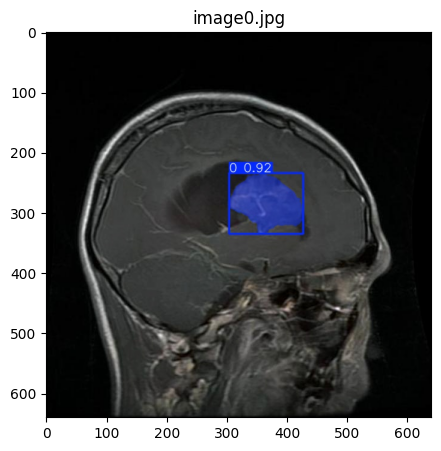

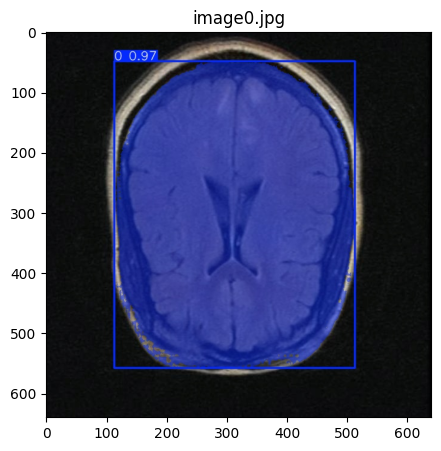

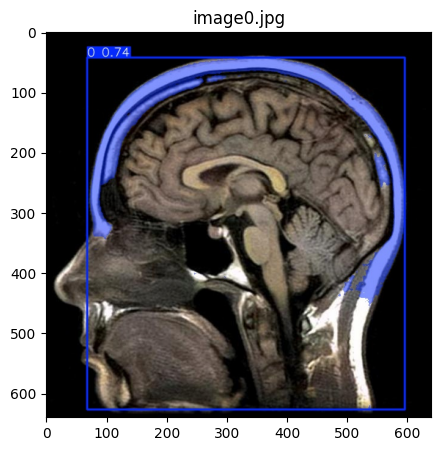

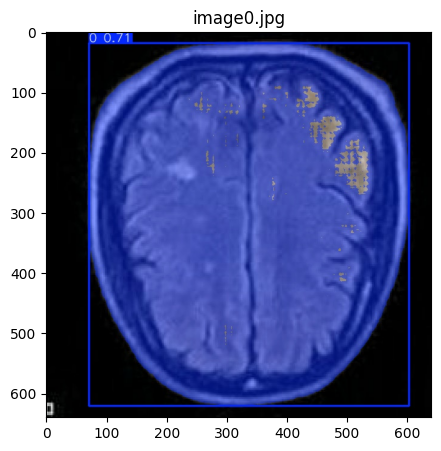

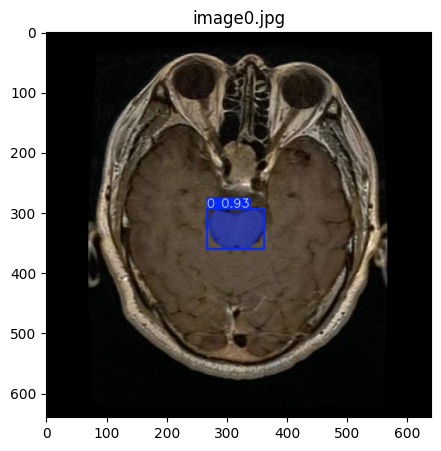

...

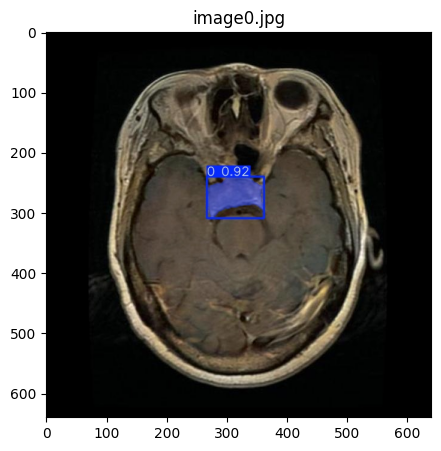

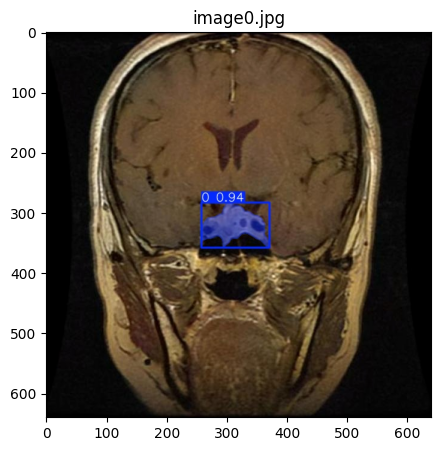

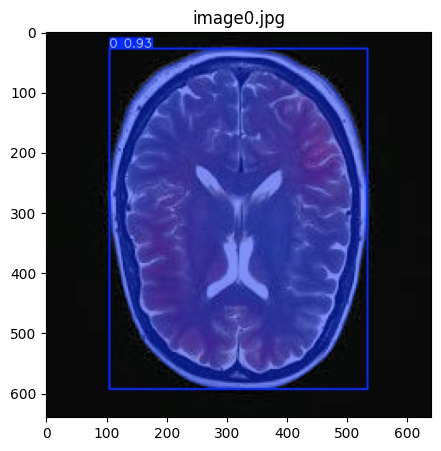

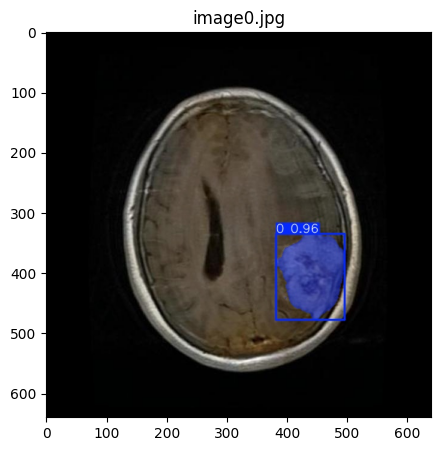

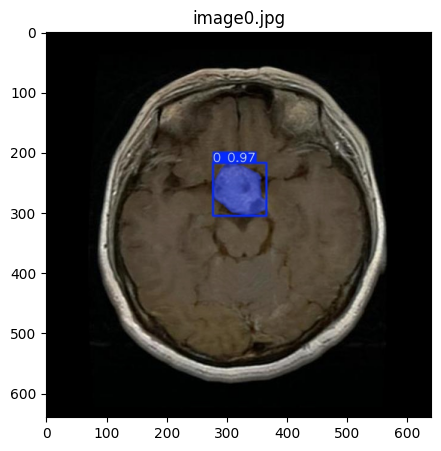

In [11]:
results_display_function(path=img_paths)

# **Download Function As Zipfile :**

In [12]:
def download(img_paths, zip_path):
    with zipfile.ZipFile(zip_path, 'w') as f:
        for img_path in img_paths:
            name=os.path.join(os.path.basename(os.path.dirname(img_path)),os.path.basename(img_path))
            f.write(img_path, arcname=name)
    print(f"Zipped [{len(img_paths)}] images to [{zip_path}]")

In [13]:
download(img_paths=img_paths, zip_path="/kaggle/working/seg_brain_tumor_images.zip")

Zipped [189] images to [/kaggle/working/seg_brain_tumor_images.zip]
